In [1]:
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


In [4]:
import librosa
import pandas as pd
import os
import datetime
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
import IPython.display as ipd
import librosa.display
import scipy
import glob
import numpy as np
import math
import warnings
import pickle
from sklearn.utils import shuffle
import zipfile
# Load the TensorBoard notebook extension.
%load_ext tensorboard
print("Loaded")

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Loaded


In [5]:
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 16348636958686627049
 xla_global_id: -1,
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 9901047808
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 3502572198882729859
 physical_device_desc: "device: 0, name: NVIDIA GeForce RTX 3080 Ti, pci bus id: 0000:01:00.0, compute capability: 8.6"
 xla_global_id: 416903419]

In [6]:
tf.random.set_seed(999)
np.random.seed(999)

In [11]:
!python -m wget "cdn.daitan.com/dataset.zip"

Traceback (most recent call last):
  File "C:\Python310\lib\runpy.py", line 196, in _run_module_as_main
    return _run_code(code, main_globals, None,
  File "C:\Python310\lib\runpy.py", line 86, in _run_code
    exec(code, run_globals)
  File "C:\Python310\lib\site-packages\wget.py", line 568, in <module>
    filename = download(args[0], out=options.output)
  File "C:\Python310\lib\site-packages\wget.py", line 526, in download
    (tmpfile, headers) = ulib.urlretrieve(binurl, tmpfile, callback)
  File "C:\Python310\lib\urllib\request.py", line 241, in urlretrieve
    with contextlib.closing(urlopen(url, data)) as fp:
  File "C:\Python310\lib\urllib\request.py", line 216, in urlopen
    return opener.open(url, data, timeout)
  File "C:\Python310\lib\urllib\request.py", line 503, in open
    req = Request(fullurl, data)
  File "C:\Python310\lib\urllib\request.py", line 322, in __init__
    self.full_url = url
  File "C:\Python310\lib\urllib\request.py", line 348, in full_url
    self._p

In [ ]:
dataset_file_name = './dataset.zip'
with zipfile.ZipFile(dataset_file_name, 'r') as zip_ref:
    zip_ref.extractall('./dataset')

In [15]:
path_to_dataset = "./records"

In [16]:
# get training and validation tf record file names
train_tfrecords_filenames = glob.glob(os.path.join(path_to_dataset, 'train_*'))
val_tfrecords_filenames = glob.glob(os.path.join(path_to_dataset, 'val_*'))

# suffle the file names for training
np.random.shuffle(train_tfrecords_filenames)
print("Training file names: ", train_tfrecords_filenames)
print("Validation file names: ", val_tfrecords_filenames)

Training file names:  ['./records\\train_2.tfrecords', './records\\train_5.tfrecords', './records\\train_3.tfrecords', './records\\train_1.tfrecords', './records\\train_4.tfrecords', './records\\train_0.tfrecords']
Validation file names:  ['./records\\val_0.tfrecords']


In [17]:
windowLength = 256
overlap      = round(0.25 * windowLength) # overlap of 75%
ffTLength    = windowLength
inputFs      = 48e3
fs           = 16e3
numFeatures  = ffTLength//2 + 1
numSegments  = 8
print("windowLength:",windowLength)
print("overlap:",overlap)
print("ffTLength:",ffTLength)
print("inputFs:",inputFs)
print("fs:",fs)
print("numFeatures:",numFeatures)
print("numSegments:",numSegments)

windowLength: 256
overlap: 64
ffTLength: 256
inputFs: 48000.0
fs: 16000.0
numFeatures: 129
numSegments: 8


In [18]:
mozilla_basepath = "./dataset/ru"
UrbanSound8K_basepath = './dataset/UrbanSound8K'

## Prepare Input features

In [19]:
def tf_record_parser(record):
    keys_to_features = {
        "noise_stft_phase": tf.io.FixedLenFeature((), tf.string, default_value=""),
        'noise_stft_mag_features': tf.io.FixedLenFeature([], tf.string),
        "clean_stft_magnitude": tf.io.FixedLenFeature((), tf.string)
    }

    features = tf.io.parse_single_example(record, keys_to_features)

    noise_stft_mag_features = tf.io.decode_raw(features['noise_stft_mag_features'], tf.float32)
    clean_stft_magnitude = tf.io.decode_raw(features['clean_stft_magnitude'], tf.float32)
    noise_stft_phase = tf.io.decode_raw(features['noise_stft_phase'], tf.float32)

    # reshape input and annotation images
    noise_stft_mag_features = tf.reshape(noise_stft_mag_features, (129, 8, 1), name="noise_stft_mag_features")
    clean_stft_magnitude = tf.reshape(clean_stft_magnitude, (129, 1, 1), name="clean_stft_magnitude")
    noise_stft_phase = tf.reshape(noise_stft_phase, (129,), name="noise_stft_phase")

    return noise_stft_mag_features, clean_stft_magnitude

## Create tf.Data.Dataset

In [20]:
train_dataset = tf.data.TFRecordDataset([train_tfrecords_filenames])
train_dataset = train_dataset.map(tf_record_parser)
train_dataset = train_dataset.shuffle(8192)
train_dataset = train_dataset.repeat()
train_dataset = train_dataset.batch(512)
train_dataset = train_dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [21]:
test_dataset = tf.data.TFRecordDataset([val_tfrecords_filenames])
test_dataset = test_dataset.map(tf_record_parser)
test_dataset = test_dataset.repeat(1)
test_dataset = test_dataset.batch(512)

## Model Training

In [22]:
from tensorflow.keras.layers import Conv2D, Input, LeakyReLU, Flatten, Dense, Reshape, Conv2DTranspose, BatchNormalization, Activation
from tensorflow.keras import Model, Sequential

In [23]:
def conv_block(x, filters, kernel_size, strides, padding='same', use_bn=True):
  x = Conv2D(filters=filters, kernel_size=kernel_size, strides=strides, padding=padding, use_bias=False,
              kernel_regularizer=tf.keras.regularizers.l2(0.0006))(x)
  x = Activation('relu')(x)
  if use_bn:
    x = BatchNormalization()(x)
  return x

In [24]:
def full_pre_activation_block(x, filters, kernel_size, strides, padding='same', use_bn=True):
  shortcut = x
  in_channels = x.shape[-1]

  x = BatchNormalization()(x)
  x = Activation('relu')(x)
  x = Conv2D(filters=filters, kernel_size=kernel_size, strides=strides, padding='same')(x)

  x = BatchNormalization()(x)
  x = Activation('relu')(x)
  x = Conv2D(filters=in_channels, kernel_size=kernel_size, strides=strides, padding='same')(x)

  return shortcut + x

In [25]:
def build_model(l2_strength):
  inputs = Input(shape=[numFeatures,numSegments,1])
  x = inputs

  # -----
  x = tf.keras.layers.ZeroPadding2D(((4,4), (0,0)))(x)
  x = Conv2D(filters=18, kernel_size=[9,8], strides=[1, 1], padding='valid', use_bias=False,
              kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = Activation('relu')(x)
  x = BatchNormalization()(x)

  skip0 = Conv2D(filters=30, kernel_size=[5,1], strides=[1, 1], padding='same', use_bias=False,
                 kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = Activation('relu')(skip0)
  x = BatchNormalization()(x)

  x = Conv2D(filters=8, kernel_size=[9,1], strides=[1, 1], padding='same', use_bias=False,
              kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = Activation('relu')(x)
  x = BatchNormalization()(x)

  # -----
  x = Conv2D(filters=18, kernel_size=[9,1], strides=[1, 1], padding='same', use_bias=False,
              kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = Activation('relu')(x)
  x = BatchNormalization()(x)

  skip1 = Conv2D(filters=30, kernel_size=[5,1], strides=[1, 1], padding='same', use_bias=False,
                 kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = Activation('relu')(skip1)
  x = BatchNormalization()(x)

  x = Conv2D(filters=8, kernel_size=[9,1], strides=[1, 1], padding='same', use_bias=False,
              kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = Activation('relu')(x)
  x = BatchNormalization()(x)

  # ----
  x = Conv2D(filters=18, kernel_size=[9,1], strides=[1, 1], padding='same', use_bias=False,
              kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = Activation('relu')(x)
  x = BatchNormalization()(x)
  
  x = Conv2D(filters=30, kernel_size=[5,1], strides=[1, 1], padding='same', use_bias=False,
              kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = Activation('relu')(x)
  x = BatchNormalization()(x)

  x = Conv2D(filters=8, kernel_size=[9,1], strides=[1, 1], padding='same', use_bias=False,
              kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = Activation('relu')(x)
  x = BatchNormalization()(x)

  # ----
  x = Conv2D(filters=18, kernel_size=[9,1], strides=[1, 1], padding='same', use_bias=False,
              kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = Activation('relu')(x)
  x = BatchNormalization()(x)

  x = Conv2D(filters=30, kernel_size=[5,1], strides=[1, 1], padding='same', use_bias=False,
             kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = x + skip1
  x = Activation('relu')(x)
  x = BatchNormalization()(x)

  x = Conv2D(filters=8, kernel_size=[9,1], strides=[1, 1], padding='same', use_bias=False,
              kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = Activation('relu')(x)
  x = BatchNormalization()(x)

  # ----
  x = Conv2D(filters=18, kernel_size=[9,1], strides=[1, 1], padding='same', use_bias=False,
              kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = Activation('relu')(x)
  x = BatchNormalization()(x)

  x = Conv2D(filters=30, kernel_size=[5,1], strides=[1, 1], padding='same', use_bias=False,
             kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = x + skip0
  x = Activation('relu')(x)
  x = BatchNormalization()(x)

  x = Conv2D(filters=8, kernel_size=[9,1], strides=[1, 1], padding='same', use_bias=False,
              kernel_regularizer=tf.keras.regularizers.l2(l2_strength))(x)
  x = Activation('relu')(x)
  x = BatchNormalization()(x)

  # ----
  x = tf.keras.layers.SpatialDropout2D(0.2)(x)
  x = Conv2D(filters=1, kernel_size=[129,1], strides=[1, 1], padding='same')(x)

  model = Model(inputs=inputs, outputs=x)

  optimizer = tf.keras.optimizers.Adam(3e-4)
  #optimizer = RAdam(total_steps=10000, warmup_proportion=0.1, min_lr=3e-4)

  model.compile(optimizer=optimizer, loss='mse', 
                metrics=[tf.keras.metrics.RootMeanSquaredError('rmse')])
  return model

In [26]:
model = build_model(l2_strength=0.0)
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 129, 8, 1)]  0           []                               
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 137, 8, 1)   0           ['input_1[0][0]']                
                                                                                                  
 conv2d (Conv2D)                (None, 129, 1, 18)   1296        ['zero_padding2d[0][0]']         
                                                                                                  
 activation (Activation)        (None, 129, 1, 18)   0           ['conv2d[0][0]']                 
                                                                                              

                                                                                                  
 batch_normalization_10 (BatchN  (None, 129, 1, 30)  120         ['activation_10[0][0]']          
 ormalization)                                                                                    
                                                                                                  
 conv2d_11 (Conv2D)             (None, 129, 1, 8)    2160        ['batch_normalization_10[0][0]'] 
                                                                                                  
 activation_11 (Activation)     (None, 129, 1, 8)    0           ['conv2d_11[0][0]']              
                                                                                                  
 batch_normalization_11 (BatchN  (None, 129, 1, 8)   32          ['activation_11[0][0]']          
 ormalization)                                                                                    
          

In [29]:
# You might need to install the following dependencies: sudo apt install python-pydot python-pydot-ng graphviz
tf.keras.utils.plot_model(model, show_shapes=True, dpi=64)

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model/model_to_dot to work.


In [30]:
%tensorboard --logdir logs

In [31]:
baseline_val_loss = model.evaluate(test_dataset)[0]
print(f"Baseline accuracy {baseline_val_loss}")

390/390 [==============================] - 13s 12ms/step - loss: 0.6060 - rmse: 0.7785
Baseline accuracy 0.606023371219635


In [32]:
def l2_norm(vector):
    return np.square(vector)

def SDR(denoised, cleaned, eps=1e-7): # Signal to Distortion Ratio
    a = l2_norm(denoised)
    b = l2_norm(denoised - cleaned)
    a_b = a / b
    return np.mean(10 * np.log10(a_b + eps))

In [33]:
early_stopping_callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True, baseline=None)

logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, update_freq='batch')
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(filepath='./denoiser_cnn_log_mel_generator.h5', 
                                                         monitor='val_loss', save_best_only=True)

model.fit(train_dataset,
         steps_per_epoch=600, # you might need to change this
         validation_data=test_dataset,
         epochs=400,
         callbacks=[early_stopping_callback, tensorboard_callback, checkpoint_callback]
        )

Epoch 1/400
600/600 [==============================] - 19s 20ms/step - loss: 0.3781 - rmse: 0.6149 - val_loss: 0.2272 - val_rmse: 0.4766
Epoch 2/400
600/600 [==============================] - 11s 19ms/step - loss: 0.2275 - rmse: 0.4769 - val_loss: 0.1986 - val_rmse: 0.4456
Epoch 3/400
600/600 [==============================] - 11s 19ms/step - loss: 0.2009 - rmse: 0.4482 - val_loss: 0.1827 - val_rmse: 0.4274
Epoch 4/400
600/600 [==============================] - 12s 21ms/step - loss: 0.1951 - rmse: 0.4417 - val_loss: 0.1772 - val_rmse: 0.4210
Epoch 5/400
600/600 [==============================] - 11s 19ms/step - loss: 0.1791 - rmse: 0.4232 - val_loss: 0.1713 - val_rmse: 0.4139
Epoch 6/400
600/600 [==============================] - 11s 18ms/step - loss: 0.1730 - rmse: 0.4160 - val_loss: 0.1625 - val_rmse: 0.4031
Epoch 7/400
600/600 [==============================] - 10s 17ms/step - loss: 0.1689 - rmse: 0.4110 - val_loss: 0.1613 - val_rmse: 0.4016
Epoch 8/400
600/600 [====================

600/600 [==============================] - 10s 16ms/step - loss: 0.1365 - rmse: 0.3694 - val_loss: 0.1394 - val_rmse: 0.3734
Epoch 61/400
600/600 [==============================] - 10s 16ms/step - loss: 0.1365 - rmse: 0.3694 - val_loss: 0.1482 - val_rmse: 0.3850
Epoch 62/400
600/600 [==============================] - 10s 17ms/step - loss: 0.1308 - rmse: 0.3616 - val_loss: 0.1401 - val_rmse: 0.3742
Epoch 63/400
600/600 [==============================] - 10s 16ms/step - loss: 0.1374 - rmse: 0.3706 - val_loss: 0.1404 - val_rmse: 0.3747
Epoch 64/400
600/600 [==============================] - 10s 16ms/step - loss: 0.1352 - rmse: 0.3677 - val_loss: 0.1402 - val_rmse: 0.3744
Epoch 65/400
600/600 [==============================] - 10s 17ms/step - loss: 0.1363 - rmse: 0.3692 - val_loss: 0.1504 - val_rmse: 0.3878
Epoch 66/400
600/600 [==============================] - 10s 16ms/step - loss: 0.1298 - rmse: 0.3603 - val_loss: 0.1394 - val_rmse: 0.3734
Epoch 67/400
600/600 [=========================

600/600 [==============================] - 10s 16ms/step - loss: 0.1313 - rmse: 0.3623 - val_loss: 0.1422 - val_rmse: 0.3771
Epoch 120/400
600/600 [==============================] - 10s 17ms/step - loss: 0.1266 - rmse: 0.3558 - val_loss: 0.1369 - val_rmse: 0.3700
Epoch 121/400
600/600 [==============================] - 10s 17ms/step - loss: 0.1342 - rmse: 0.3663 - val_loss: 0.1432 - val_rmse: 0.3784
Epoch 122/400
600/600 [==============================] - 10s 17ms/step - loss: 0.1357 - rmse: 0.3684 - val_loss: 0.1547 - val_rmse: 0.3933
Epoch 123/400
600/600 [==============================] - 10s 16ms/step - loss: 0.1325 - rmse: 0.3640 - val_loss: 0.1385 - val_rmse: 0.3722
Epoch 124/400
600/600 [==============================] - 10s 16ms/step - loss: 0.1330 - rmse: 0.3647 - val_loss: 0.1342 - val_rmse: 0.3663
Epoch 125/400
600/600 [==============================] - 10s 16ms/step - loss: 0.1339 - rmse: 0.3659 - val_loss: 0.1375 - val_rmse: 0.3708
Epoch 126/400
600/600 [==================

600/600 [==============================] - 10s 16ms/step - loss: 0.1300 - rmse: 0.3605 - val_loss: 0.1362 - val_rmse: 0.3690
Epoch 179/400
600/600 [==============================] - 10s 16ms/step - loss: 0.1321 - rmse: 0.3635 - val_loss: 0.1341 - val_rmse: 0.3662
Epoch 180/400
600/600 [==============================] - 10s 17ms/step - loss: 0.1244 - rmse: 0.3527 - val_loss: 0.1373 - val_rmse: 0.3705
Epoch 181/400
600/600 [==============================] - 10s 16ms/step - loss: 0.1277 - rmse: 0.3573 - val_loss: 0.1328 - val_rmse: 0.3644
Epoch 182/400
600/600 [==============================] - 10s 17ms/step - loss: 0.1300 - rmse: 0.3605 - val_loss: 0.1381 - val_rmse: 0.3717
Epoch 183/400
600/600 [==============================] - 10s 16ms/step - loss: 0.1252 - rmse: 0.3538 - val_loss: 0.1353 - val_rmse: 0.3679
Epoch 184/400
600/600 [==============================] - 10s 17ms/step - loss: 0.1298 - rmse: 0.3603 - val_loss: 0.1341 - val_rmse: 0.3662
Epoch 185/400
600/600 [==================

600/600 [==============================] - 13s 21ms/step - loss: 0.1233 - rmse: 0.3511 - val_loss: 0.1362 - val_rmse: 0.3690
Epoch 238/400
600/600 [==============================] - 13s 21ms/step - loss: 0.1297 - rmse: 0.3602 - val_loss: 0.1345 - val_rmse: 0.3668
Epoch 239/400
600/600 [==============================] - 13s 21ms/step - loss: 0.1280 - rmse: 0.3578 - val_loss: 0.1388 - val_rmse: 0.3725
Epoch 240/400
600/600 [==============================] - 13s 21ms/step - loss: 0.1284 - rmse: 0.3584 - val_loss: 0.1365 - val_rmse: 0.3695
Epoch 241/400
600/600 [==============================] - 13s 21ms/step - loss: 0.1222 - rmse: 0.3495 - val_loss: 0.1388 - val_rmse: 0.3726
Epoch 242/400
600/600 [==============================] - 13s 21ms/step - loss: 0.1284 - rmse: 0.3583 - val_loss: 0.1364 - val_rmse: 0.3693
Epoch 243/400
600/600 [==============================] - 13s 21ms/step - loss: 0.1327 - rmse: 0.3643 - val_loss: 0.1319 - val_rmse: 0.3632
Epoch 244/400
600/600 [==================

600/600 [==============================] - 13s 22ms/step - loss: 0.1291 - rmse: 0.3593 - val_loss: 0.1432 - val_rmse: 0.3784
Epoch 297/400
600/600 [==============================] - 13s 22ms/step - loss: 0.1313 - rmse: 0.3624 - val_loss: 0.1336 - val_rmse: 0.3655
Epoch 298/400
600/600 [==============================] - 13s 22ms/step - loss: 0.1276 - rmse: 0.3572 - val_loss: 0.1302 - val_rmse: 0.3608
Epoch 299/400
600/600 [==============================] - 13s 22ms/step - loss: 0.1293 - rmse: 0.3596 - val_loss: 0.1339 - val_rmse: 0.3659
Epoch 300/400
600/600 [==============================] - 13s 22ms/step - loss: 0.1289 - rmse: 0.3590 - val_loss: 0.1338 - val_rmse: 0.3658
Epoch 301/400
600/600 [==============================] - 13s 22ms/step - loss: 0.1236 - rmse: 0.3515 - val_loss: 0.1328 - val_rmse: 0.3644
Epoch 302/400
600/600 [==============================] - 13s 22ms/step - loss: 0.1231 - rmse: 0.3509 - val_loss: 0.1421 - val_rmse: 0.3770
Epoch 303/400
600/600 [==================

In [34]:
val_loss = model.evaluate(test_dataset)[0]
if val_loss < baseline_val_loss:
  print("New model saved.")
  model.save('./denoiser_cnn_log_mel_generator.h5')

390/390 [==============================] - 3s 8ms/step - loss: 0.1277 - rmse: 0.3574
New model saved.


## Testing

In [35]:
def read_audio(filepath, sample_rate, normalize=True):
    """Read an audio file and return it as a numpy array"""
    audio, sr = librosa.load(filepath, sr=sample_rate)
    if normalize:
      div_fac = 1 / np.max(np.abs(audio)) / 3.0
      audio = audio * div_fac
    return audio, sr
        
def add_noise_to_clean_audio(clean_audio, noise_signal):
    """Adds noise to an audio sample"""
    if len(clean_audio) >= len(noise_signal):
        # print("The noisy signal is smaller than the clean audio input. Duplicating the noise.")
        while len(clean_audio) >= len(noise_signal):
            noise_signal = np.append(noise_signal, noise_signal)

    ## Extract a noise segment from a random location in the noise file
    ind = np.random.randint(0, noise_signal.size - clean_audio.size)

    noiseSegment = noise_signal[ind: ind + clean_audio.size]

    speech_power = np.sum(clean_audio ** 2)
    noise_power = np.sum(noiseSegment ** 2)
    noisyAudio = clean_audio + np.sqrt(speech_power / noise_power) * noiseSegment
    return noisyAudio

def play(audio, sample_rate):
    ipd.display(ipd.Audio(data=audio, rate=sample_rate))  # load a local WAV file

In [36]:
class FeatureExtractor:
    def __init__(self, audio, *, windowLength, overlap, sample_rate):
        self.audio = audio
        self.ffT_length = windowLength
        self.window_length = windowLength
        self.overlap = overlap
        self.sample_rate = sample_rate
        self.window = scipy.signal.hamming(self.window_length, sym=False)

    def get_stft_spectrogram(self):
        return librosa.stft(self.audio, n_fft=self.ffT_length, win_length=self.window_length, hop_length=self.overlap,
                            window=self.window, center=True)

    def get_audio_from_stft_spectrogram(self, stft_features):
        return librosa.istft(stft_features, win_length=self.window_length, hop_length=self.overlap,
                             window=self.window, center=True)

    def get_mel_spectrogram(self):
        return librosa.feature.melspectrogram(self.audio, sr=self.sample_rate, power=2.0, pad_mode='reflect',
                                           n_fft=self.ffT_length, hop_length=self.overlap, center=True)

    def get_audio_from_mel_spectrogram(self, M):
        return librosa.feature.inverse.mel_to_audio(M, sr=self.sample_rate, n_fft=self.ffT_length, hop_length=self.overlap,
                                             win_length=self.window_length, window=self.window,
                                             center=True, pad_mode='reflect', power=2.0, n_iter=32, length=None)

In [ ]:
# cleanAudio, sr = read_audio(os.path.join(mozilla_basepath, 'test', 'common_voice_en_16526.mp3'), sample_rate=fs)
# print("Min:", np.min(cleanAudio),"Max:",np.max(cleanAudio))
# ipd.Audio(data=cleanAudio, rate=sr) # load a local WAV file

In [ ]:
# noiseAudio, sr = read_audio(os.path.join(UrbanSound8K_basepath, 'test', '7913-3-0-0.wav'), sample_rate=fs)
# print("Min:", np.min(noiseAudio),"Max:",np.max(noiseAudio))
# ipd.Audio(data=noiseAudio, rate=sr) # load a local WAV file

In [ ]:
# cleanAudioFeatureExtractor = FeatureExtractor(cleanAudio, windowLength=windowLength, overlap=overlap, sample_rate=sr)
# stft_features = cleanAudioFeatureExtractor.get_stft_spectrogram()
# stft_features = np.abs(stft_features)
# print("Min:", np.min(stft_features),"Max:",np.max(stft_features))

In [ ]:
# noisyAudio = add_noise_to_clean_audio(cleanAudio, noiseAudio)
# ipd.Audio(data=noisyAudio, rate=fs) # load a local WAV file

In [42]:
noisyAudio, sr = read_audio("./buran_16.wav", sample_rate=fs)
ipd.Audio(data=noisyAudio, rate=sr)

In [43]:
def prepare_input_features(stft_features):
    # Phase Aware Scaling: To avoid extreme differences (more than
    # 45 degree) between the noisy and clean phase, the clean spectral magnitude was encoded as similar to [21]:
    noisySTFT = np.concatenate([stft_features[:,0:numSegments-1], stft_features], axis=1)
    stftSegments = np.zeros((numFeatures, numSegments , noisySTFT.shape[1] - numSegments + 1))

    for index in range(noisySTFT.shape[1] - numSegments + 1):
        stftSegments[:,:,index] = noisySTFT[:,index:index + numSegments]
    return stftSegments

In [44]:
noiseAudioFeatureExtractor = FeatureExtractor(noisyAudio, windowLength=windowLength, overlap=overlap, sample_rate=sr)
noise_stft_features = noiseAudioFeatureExtractor.get_stft_spectrogram()

# Paper: Besides, spectral phase was not used in the training phase.
# At reconstruction, noisy spectral phase was used instead to
# perform in- verse STFT and recover human speech.
noisyPhase = np.angle(noise_stft_features)
print(noisyPhase.shape)
noise_stft_features = np.abs(noise_stft_features)

mean = np.mean(noise_stft_features)
std = np.std(noise_stft_features)
noise_stft_features = (noise_stft_features - mean) / std

(129, 196941)


In [45]:
predictors = prepare_input_features(noise_stft_features)

In [46]:
predictors = np.reshape(predictors, (predictors.shape[0], predictors.shape[1], 1, predictors.shape[2]))
predictors = np.transpose(predictors, (3, 0, 1, 2)).astype(np.float32)
print('predictors.shape:', predictors.shape)

predictors.shape: (196941, 129, 8, 1)


In [47]:
STFTFullyConvolutional = model.predict(predictors)
print(STFTFullyConvolutional.shape)

(196941, 129, 1, 1)


In [48]:
def revert_features_to_audio(features, phase, cleanMean=None, cleanStd=None):
    # scale the outpus back to the original range
    if cleanMean and cleanStd:
        features = cleanStd * features + cleanMean

    phase = np.transpose(phase, (1, 0))
    features = np.squeeze(features)

    # features = librosa.db_to_power(features)
    features = features * np.exp(1j * phase)  # that fixes the abs() ope previously done

    features = np.transpose(features, (1, 0))
    return noiseAudioFeatureExtractor.get_audio_from_stft_spectrogram(features)

In [51]:
denoisedAudioFullyConvolutional = revert_features_to_audio(STFTFullyConvolutional, noisyPhase, mean, std)
print("Min:", np.min(denoisedAudioFullyConvolutional),"Max:",np.max(denoisedAudioFullyConvolutional))
ipd.Audio(data=denoisedAudioFullyConvolutional, rate=fs) # load a local WAV file

Min: -0.17460601 Max: 0.24059172


AttributeError: module 'librosa' has no attribute 'output'

In [ ]:
# A numeric identifier of the sound class -- Types of noise
# 0 = air_conditioner
# 1 = car_horn
# 2 = children_playing
# 3 = dog_bark
# 4 = drilling
# 5 = engine_idling
# 6 = gun_shot
# 7 = jackhammer
# 8 = siren
# 9 = street_music

Text(0.5, 1.0, 'Denoised Audio')

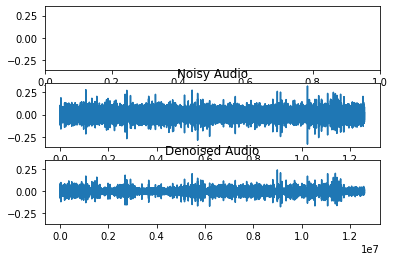

In [50]:
f, (ax1, ax2, ax3) = plt.subplots(3, 1, sharey=True)

# ax1.plot(cleanAudio)
# ax1.set_title("Clean Audio")

ax2.plot(noisyAudio)
ax2.set_title("Noisy Audio")

ax3.plot(denoisedAudioFullyConvolutional)
ax3.set_title("Denoised Audio")

In [53]:
import soundfile as sf
sf.write("./buran_denoised.wav", denoisedAudioFullyConvolutional, 16000, subtype="PCM_16")